## This script contains the following points:

1. Import libraries and data sets.
2. Split data by decades and transform data sets into the correct shape to feed to the deep learning model.
3. Create and run random forest model and print accuracy for each decade. Plot decision trees for 1960s, 1980s, 2000s, and 2020s data.
4. Create a list of the feature importances of the model and find which weather stations have the most influence on how the random forest divides up data.
5. Plot a bar chart of the importances against a list of the weather stations.
6. Create three subsets of original data set (including all decades): One subset for each of the top three most important stations from Section 5 directly above.
7. Create another random forest model for each of the 3 stations from Section 6 and graph the importance of the observations.

### 1. Import libraries and data sets.

In [1]:
# Import libraries.

import pandas as pd
import numpy as np
import seaborn as sns
import os
import operator
import datetime as dt
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from numpy import argmax
from sklearn import metrics  
from sklearn.tree import plot_tree
from sklearn import tree

In [2]:
# Establish path.

path = r'/Users/juliareeves/Documents/WorkWorkWork/CareerFoundry/Machine Learning Python 2'
path

'/Users/juliareeves/Documents/WorkWorkWork/CareerFoundry/Machine Learning Python 2'

In [3]:
# Import cleaned weather data set.

df_w = pd.read_csv(os.path.join(path, 'Data Sets', 'Cleaned Data', 'temperatures_data_set_cleaned.csv'), index_col = False)
df_w

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,19600101,1,7,0.85,1.0180,0.32,0.09,0.7,6.5,0.8,...,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,19600102,1,6,0.84,1.0180,0.36,1.05,1.1,6.1,3.3,...,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,19600103,1,8,0.90,1.0180,0.18,0.30,0.0,8.5,5.1,...,4.1,7,0.91,1.0096,0.17,0.08,0.1,10.5,8.1,12.9
3,19600104,1,3,0.92,1.0180,0.58,0.00,4.1,6.3,3.8,...,2.3,7,0.86,1.0184,0.13,0.98,0.0,7.4,7.3,10.6
4,19600105,1,6,0.95,1.0180,0.65,0.14,5.4,3.0,-0.7,...,4.3,3,0.80,1.0328,0.46,0.00,5.7,5.7,3.0,8.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,20221027,10,1,0.79,1.0248,1.34,0.22,7.7,15.9,11.4,...,14.2,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22946,20221028,10,6,0.77,1.0244,1.34,0.22,5.4,16.7,14.3,...,14.3,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22947,20221029,10,4,0.76,1.0227,1.34,0.22,6.1,16.7,13.1,...,14.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22948,20221030,10,5,0.80,1.0212,1.34,0.22,5.8,15.4,11.6,...,12.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5


In [4]:
# Import cleaned pleasant weather data set.

df_pw = pd.read_csv(os.path.join(path, 'Data Sets', 'Cleaned Data', 'pleasant_weather_data_set_cleaned.csv'), index_col = False)
df_pw

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
0,19600101,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,19600102,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,19600103,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,19600104,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,19600105,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,20221027,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22946,20221028,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22947,20221029,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22948,20221030,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [5]:
# Set tensorflow random seed generator.

tf.random.set_seed(42)

In [6]:
# Define cities.

cities = [
    "Basel",
    "Belgrade",
    "Budapest",
    "Debilt",
    "Dusseldorf",
    "Heathrow",
    "Kassel",
    "Ljubljana",
    "Maastricht",
    "Madrid",
    "Munchen",
    "Oslo",
    "Sonnblick",
    "Stockholm",
    "Valentia"
]

In [7]:
# Define weather observations.

observations = [
    "cloud_cover",
    "humidity",
    "pressure",
    "global_radiation",
    "precipitation",
    "sunshine",
    "temp_mean",
    "temp_min",
    "temp_max"
]

In [8]:
# Define predictions (i.e. binary pleasant or unpleasant weather label).

predictions = {
    0: 'Pleasant weather',
    1: 'Unpleasant weather',
}

### 2. Split data by decades and transform data sets into the correct shape to feed to the deep learning model.

In [9]:
# Examine "DATE" data type for weather observations.

df_w['DATE'].dtype

dtype('int64')

In [10]:
# Examine "DATE" data type for pleasant weather labels.

df_pw['DATE'].dtype

dtype('int64')

In [11]:
# Convert DATE data types for both data frames to datetime.

df_w["DATE"] = df_w["DATE"].apply(pd.to_datetime, format = '%Y%m%d') # Convert DATE column for weather observations data set.
df_pw["DATE"] = df_pw["DATE"].apply(pd.to_datetime, format = '%Y%m%d') # Convert DATE column for pleasant weather labels data set.

In [12]:
df_w

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,1960-01-01,1,7,0.85,1.0180,0.32,0.09,0.7,6.5,0.8,...,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,1960-01-02,1,6,0.84,1.0180,0.36,1.05,1.1,6.1,3.3,...,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,1960-01-03,1,8,0.90,1.0180,0.18,0.30,0.0,8.5,5.1,...,4.1,7,0.91,1.0096,0.17,0.08,0.1,10.5,8.1,12.9
3,1960-01-04,1,3,0.92,1.0180,0.58,0.00,4.1,6.3,3.8,...,2.3,7,0.86,1.0184,0.13,0.98,0.0,7.4,7.3,10.6
4,1960-01-05,1,6,0.95,1.0180,0.65,0.14,5.4,3.0,-0.7,...,4.3,3,0.80,1.0328,0.46,0.00,5.7,5.7,3.0,8.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,2022-10-27,10,1,0.79,1.0248,1.34,0.22,7.7,15.9,11.4,...,14.2,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22946,2022-10-28,10,6,0.77,1.0244,1.34,0.22,5.4,16.7,14.3,...,14.3,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22947,2022-10-29,10,4,0.76,1.0227,1.34,0.22,6.1,16.7,13.1,...,14.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22948,2022-10-30,10,5,0.80,1.0212,1.34,0.22,5.8,15.4,11.6,...,12.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5


In [13]:
# Create dataframe of weather observations from 1960s.

df_w_1960s = df_w.loc[(df_w["DATE"].dt.year >= 1960) & (df_w["DATE"].dt.year < 1970)]
df_w_1960s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,1960-01-01,1,7,0.85,1.018,0.32,0.09,0.7,6.5,0.8,...,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,1960-01-02,1,6,0.84,1.018,0.36,1.05,1.1,6.1,3.3,...,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,1960-01-03,1,8,0.90,1.018,0.18,0.30,0.0,8.5,5.1,...,4.1,7,0.91,1.0096,0.17,0.08,0.1,10.5,8.1,12.9
3,1960-01-04,1,3,0.92,1.018,0.58,0.00,4.1,6.3,3.8,...,2.3,7,0.86,1.0184,0.13,0.98,0.0,7.4,7.3,10.6
4,1960-01-05,1,6,0.95,1.018,0.65,0.14,5.4,3.0,-0.7,...,4.3,3,0.80,1.0328,0.46,0.00,5.7,5.7,3.0,8.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3648,1969-12-27,12,8,0.80,1.018,0.18,0.00,0.0,-3.1,-5.0,...,0.7,6,0.84,1.0239,0.24,0.00,0.1,3.4,-1.2,7.0
3649,1969-12-28,12,8,0.83,1.018,0.18,0.00,0.0,-3.5,-4.0,...,1.7,6,0.73,1.0044,0.33,0.01,2.7,5.4,2.1,8.8
3650,1969-12-29,12,5,0.82,1.018,0.67,0.00,6.5,-3.7,-4.7,...,1.8,7,0.74,0.9972,0.12,0.00,0.0,3.8,2.5,6.3
3651,1969-12-30,12,8,0.83,1.018,0.18,0.00,0.0,-3.9,-6.1,...,-2.7,5,0.70,1.0093,0.43,0.00,3.8,2.9,1.2,5.1


In [14]:
# Create dataframe of pleasant weather labels from 1960s.

df_pw_1960s = df_pw.loc[(df_pw["DATE"].dt.year >= 1960) & (df_w["DATE"].dt.year < 1970)]
df_pw_1960s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
0,1960-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1960-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1960-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1960-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1960-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3648,1969-12-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3649,1969-12-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3650,1969-12-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3651,1969-12-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [15]:
# Create function to take a subset of a dataframe between two years.

def date_subset(df, d1, d2):
    df_subset = df.loc[(df["DATE"].dt.year >= d1) & (df["DATE"].dt.year < d2)]
    return df_subset


In [16]:
# Create data frame of weather observations from the 1970s.

df_w_1970s = date_subset(df=df_w, d1=1970, d2=1980)
df_w_1970s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
3653,1970-01-01,1,8,0.83,1.018,0.18,0.00,0.0,-3.6,-4.1,...,-4.9,7,0.78,1.0156,0.28,0.18,0.6,3.2,-0.7,5.8
3654,1970-01-02,1,5,0.77,1.018,0.18,0.00,0.0,-4.1,-5.3,...,-1.2,6,0.93,1.0091,0.32,0.17,2.0,4.7,0.7,8.6
3655,1970-01-03,1,3,0.76,1.018,0.66,0.00,5.9,-2.2,-7.5,...,-6.9,4,0.86,1.0048,0.34,0.20,1.7,5.4,2.6,8.1
3656,1970-01-04,1,6,0.84,1.018,0.18,2.03,0.0,-0.8,-4.3,...,-3.6,1,0.74,1.0053,0.56,0.23,6.3,1.9,-0.2,3.9
3657,1970-01-05,1,8,0.91,1.018,0.18,0.65,0.0,2.2,-0.1,...,-13.0,3,0.86,1.0047,0.49,0.17,4.4,2.2,-2.0,6.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7300,1979-12-27,12,7,0.74,1.018,0.63,0.07,5.6,2.2,-0.3,...,2.0,7,0.78,0.9978,0.24,0.22,0.6,6.7,6.1,9.0
7301,1979-12-28,12,7,0.85,1.018,0.32,0.10,0.8,3.5,0.5,...,2.4,4,0.81,1.0062,0.26,0.47,1.7,6.3,4.6,8.0
7302,1979-12-29,12,7,0.79,1.018,0.30,0.29,0.6,3.7,1.5,...,2.4,5,0.74,1.0055,0.28,0.31,2.5,5.5,4.0,7.0
7303,1979-12-30,12,6,0.87,1.018,0.39,1.14,1.5,2.2,0.5,...,2.4,4,0.82,1.0125,0.41,0.02,4.6,4.6,1.2,8.0


In [17]:
# Create data frame of pleasant weather labels from the 1970s.

df_pw_1970s = date_subset(df=df_pw, d1=1970, d2=1980)
df_pw_1970s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
3653,1970-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3654,1970-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3655,1970-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3656,1970-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3657,1970-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7300,1979-12-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7301,1979-12-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7302,1979-12-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7303,1979-12-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [18]:
# Create data frame of weather observations from the 1980s.

df_w_1980s = date_subset(df=df_w, d1=1980, d2=1990)
df_w_1980s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
7305,1980-01-01,1,6,0.83,1.0180,0.40,0.01,1.6,-0.8,-4.4,...,1.1,6,0.90,1.0130,0.17,0.05,0.0,4.4,2.1,6.0
7306,1980-01-02,1,5,0.84,1.0180,0.34,0.09,0.9,-1.7,-4.0,...,-1.2,7,0.89,1.0195,0.12,1.48,0.0,6.4,1.0,11.5
7307,1980-01-03,1,8,0.80,1.0180,0.44,0.07,2.0,-0.6,-3.7,...,-5.0,8,0.95,1.0058,0.13,0.60,0.0,9.2,6.2,12.2
7308,1980-01-04,1,8,0.94,1.0180,0.18,0.43,0.0,-0.9,-2.2,...,-5.4,5,0.80,1.0034,0.30,0.50,1.5,7.7,5.8,9.2
7309,1980-01-05,1,8,0.90,1.0180,0.25,0.26,0.2,3.0,0.5,...,0.2,7,0.79,1.0134,0.22,0.03,0.1,7.6,6.1,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10953,1989-12-27,12,6,0.87,1.0157,0.49,0.00,4.0,-0.9,-2.4,...,4.0,6,0.79,1.0105,0.22,0.12,0.1,6.0,1.8,10.1
10954,1989-12-28,12,3,0.84,1.0196,0.54,0.00,6.4,-1.1,-2.8,...,2.2,8,0.84,1.0134,0.18,0.05,0.3,9.3,7.5,11.0
10955,1989-12-29,12,4,0.85,1.0224,0.52,0.00,5.5,-1.7,-4.5,...,0.4,8,0.86,1.0110,0.12,1.10,0.0,10.1,8.8,11.4
10956,1989-12-30,12,0,0.83,1.0233,0.57,0.00,6.6,-2.1,-4.3,...,-0.5,8,0.84,1.0138,0.16,0.49,0.1,9.9,8.2,10.8


In [19]:
# Create data frame of pleasant weather labels from the 1980s.

df_pw_1980s = date_subset(df=df_pw, d1=1980, d2=1990)
df_pw_1980s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
7305,1980-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7306,1980-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7307,1980-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7308,1980-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7309,1980-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10953,1989-12-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10954,1989-12-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10955,1989-12-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10956,1989-12-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [20]:
# Create data frame of weather observations from the 1990s.

df_w_1990s = date_subset(df=df_w, d1=1990, d2=2000)
df_w_1990s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
10958,1990-01-01,1,0,0.83,1.0217,0.60,0.00,7.2,-2.1,-3.6,...,-0.3,3,0.82,1.0068,0.20,0.51,2.0,6.9,4.5,9.4
10959,1990-01-02,1,2,0.84,1.0238,0.48,0.00,2.3,-1.8,-3.9,...,-3.4,5,0.79,1.0040,0.21,1.48,0.1,7.3,4.7,9.9
10960,1990-01-03,1,8,0.89,1.0231,0.20,0.00,0.0,-2.2,-4.2,...,-2.6,4,0.90,1.0094,0.38,0.00,4.9,7.8,4.8,10.7
10961,1990-01-04,1,2,0.77,1.0265,0.54,0.00,5.6,-0.7,-3.1,...,0.5,6,0.93,1.0112,0.13,0.92,0.0,6.5,2.0,11.0
10962,1990-01-05,1,7,0.81,1.0286,0.23,0.04,0.2,0.0,-3.1,...,0.8,4,0.91,1.0108,0.20,0.56,1.2,9.4,7.2,11.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14605,1999-12-27,12,7,0.74,0.9953,0.28,1.93,1.0,5.0,1.5,...,1.6,7,0.75,0.9954,0.15,0.41,0.1,4.8,3.0,7.5
14606,1999-12-28,12,8,0.88,0.9956,0.13,1.22,0.0,2.4,1.0,...,1.0,3,0.73,1.0102,0.41,0.03,5.1,5.3,2.5,8.1
14607,1999-12-29,12,8,0.84,1.0162,0.21,0.11,0.1,1.8,1.0,...,-1.1,5,0.81,1.0229,0.35,0.85,3.9,7.1,4.2,9.1
14608,1999-12-30,12,7,0.80,1.0276,0.26,0.01,0.5,1.1,-0.3,...,-2.5,8,0.94,1.0171,0.14,0.27,0.0,8.4,5.5,11.2


In [21]:
# Create data frame of pleasant weather labels from the 1990s.

df_pw_1990s = date_subset(df=df_pw, d1=1990, d2=2000)
df_pw_1990s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
10958,1990-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10959,1990-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10960,1990-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10961,1990-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10962,1990-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14605,1999-12-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14606,1999-12-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14607,1999-12-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14608,1999-12-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [22]:
# Create data frame of weather observations from the 2000s.

df_w_2000s = date_subset(df=df_w, d1=2000, d2=2010)
df_w_2000s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
14610,2000-01-01,1,8,0.89,1.0286,0.20,0.03,0.0,2.9,1.6,...,0.7,6,0.89,1.0235,0.22,0.10,0.7,6.6,2.1,11.0
14611,2000-01-02,1,8,0.87,1.0318,0.25,0.00,0.0,3.6,2.7,...,2.0,8,0.92,1.0177,0.13,0.42,0.0,9.6,7.3,10.6
14612,2000-01-03,1,5,0.81,1.0314,0.50,0.00,3.7,2.2,0.1,...,2.8,4,0.79,1.0154,0.22,1.05,1.2,8.6,7.3,9.9
14613,2000-01-04,1,7,0.79,1.0262,0.63,0.35,6.9,3.9,0.5,...,4.6,6,0.76,1.0099,0.36,0.34,3.5,8.1,5.0,7.7
14614,2000-01-05,1,5,0.90,1.0246,0.51,0.07,3.7,6.0,3.8,...,2.9,7,0.81,0.9957,0.12,0.33,0.0,7.7,4.0,11.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18258,2009-12-27,12,7,0.80,1.0118,0.37,0.18,2.3,1.0,-3.9,...,-2.7,4,0.72,1.0039,0.37,0.01,4.7,7.2,5.8,8.5
18259,2009-12-28,12,7,0.82,1.0084,0.28,0.42,0.3,3.2,1.0,...,2.4,8,0.70,0.9975,0.22,1.25,0.0,4.8,1.4,8.3
18260,2009-12-29,12,7,0.92,1.0028,0.22,1.68,0.2,4.5,2.4,...,0.8,8,0.88,0.9866,0.12,2.84,0.0,3.4,2.6,4.2
18261,2009-12-30,12,8,0.92,0.9979,0.18,1.54,0.0,8.5,7.5,...,-7.4,8,0.87,0.9862,0.12,1.46,0.0,3.1,2.1,4.2


In [23]:
# Create data frame of pleasant weather labels from the 2000s.

df_pw_2000s = date_subset(df=df_pw, d1=2000, d2=2010)
df_pw_2000s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
14610,2000-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14611,2000-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14612,2000-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14613,2000-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14614,2000-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18258,2009-12-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18259,2009-12-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18260,2009-12-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18261,2009-12-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [24]:
# Create data frame of weather observations from the 2010s.

df_w_2010s = date_subset(df=df_w, d1=2010, d2=2020)
df_w_2010s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
18263,2010-01-01,1,8,0.93,0.9965,0.18,0.56,0.0,2.9,-0.2,...,-7.0,1,0.80,1.0121,0.43,0.00,6.0,1.7,-1.6,5.0
18264,2010-01-02,1,3,0.74,1.0193,0.58,0.00,5.2,-1.5,-4.2,...,-7.1,1,0.82,1.0196,0.45,0.00,6.0,0.8,-4.5,6.2
18265,2010-01-03,1,3,0.75,1.0226,0.61,0.00,6.3,-3.2,-6.0,...,-7.1,4,0.71,1.0196,0.36,0.41,1.6,0.5,-4.1,5.1
18266,2010-01-04,1,5,0.83,1.0169,0.48,0.00,3.7,-4.9,-8.3,...,-3.6,2,0.67,1.0219,0.48,0.51,6.5,3.7,1.3,3.8
18267,2010-01-05,1,7,0.78,1.0073,0.53,0.04,4.4,-4.0,-7.1,...,-5.5,4,0.78,1.0117,0.45,0.09,4.7,2.3,-0.7,5.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21910,2019-12-27,12,8,0.92,1.0273,0.15,0.52,0.1,6.8,5.6,...,0.2,5,0.82,1.0142,0.04,0.41,3.4,10.7,7.9,13.5
21911,2019-12-28,12,7,0.86,1.0380,0.35,0.00,1.3,3.7,-0.6,...,-1.0,5,0.82,1.0142,0.20,0.41,3.4,10.7,7.9,13.5
21912,2019-12-29,12,6,0.93,1.0387,0.61,0.00,4.9,-0.8,-2.7,...,5.8,5,0.82,1.0142,0.24,0.41,3.4,10.7,7.9,13.5
21913,2019-12-30,12,1,0.81,1.0354,0.64,0.00,6.5,0.5,-3.0,...,9.6,5,0.82,1.0142,0.06,0.41,3.4,10.7,7.9,13.5


In [25]:
# Create data frame of pleasant weather labels from the 2010s.

df_pw_2010s = date_subset(df=df_pw, d1=2010, d2=2020)
df_pw_2010s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
18263,2010-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18264,2010-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18265,2010-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18266,2010-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18267,2010-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21910,2019-12-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21911,2019-12-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21912,2019-12-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21913,2019-12-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [26]:
# Create data frame of weather observations from the 2020s.

df_w_2020s = date_subset(df=df_w, d1=2020, d2=2024)
df_w_2020s

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
21915,2020-01-01,1,0,0.87,1.0339,0.64,0.00,6.5,-0.4,-3.4,...,5.2,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
21916,2020-01-02,1,0,0.87,1.0316,0.65,0.00,6.5,0.1,-2.0,...,6.8,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
21917,2020-01-03,1,7,0.81,1.0287,0.41,0.01,1.6,5.3,0.8,...,8.3,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
21918,2020-01-04,1,6,0.79,1.0341,0.29,0.14,0.9,6.0,2.3,...,4.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
21919,2020-01-05,1,0,0.85,1.0367,0.67,0.00,6.6,1.7,-1.5,...,1.9,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,2022-10-27,10,1,0.79,1.0248,1.34,0.22,7.7,15.9,11.4,...,14.2,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22946,2022-10-28,10,6,0.77,1.0244,1.34,0.22,5.4,16.7,14.3,...,14.3,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22947,2022-10-29,10,4,0.76,1.0227,1.34,0.22,6.1,16.7,13.1,...,14.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22948,2022-10-30,10,5,0.80,1.0212,1.34,0.22,5.8,15.4,11.6,...,12.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5


In [27]:
# Create data frame of pleasant weather labels from the 2020s.

df_pw_2020s = date_subset(df=df_pw, d1=2020, d2=2024)
df_pw_2020s

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
21915,2020-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21916,2020-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21917,2020-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21918,2020-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21919,2020-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,2022-10-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22946,2022-10-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22947,2022-10-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22948,2022-10-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [28]:
# Create 'X' matrices by dropping "DATE" and "MONTH" columns from each dataframe of weather observations by decade.

X_1960s = df_w_1960s.drop(['DATE', 'MONTH'], axis=1)
X_1970s = df_w_1970s.drop(['DATE', 'MONTH'], axis=1)
X_1980s = df_w_1980s.drop(['DATE', 'MONTH'], axis=1)
X_1990s = df_w_1990s.drop(['DATE', 'MONTH'], axis=1)
X_2000s = df_w_2000s.drop(['DATE', 'MONTH'], axis=1)
X_2010s = df_w_2010s.drop(['DATE', 'MONTH'], axis=1)
X_2020s = df_w_2020s.drop(['DATE', 'MONTH'], axis=1)


In [30]:
# Create 'y' matrices by dropping "DATE" column from each dataframe of pleasant weather labels by decade.

y_1960s = df_pw_1960s.drop(['DATE'], axis=1)
y_1970s = df_pw_1970s.drop(['DATE'], axis=1)
y_1980s = df_pw_1980s.drop(['DATE'], axis=1)
y_1990s = df_pw_1990s.drop(['DATE'], axis=1)
y_2000s = df_pw_2000s.drop(['DATE'], axis=1)
y_2010s = df_pw_2010s.drop(['DATE'], axis=1)
y_2020s = df_pw_2020s.drop(['DATE'], axis=1)

In [31]:
# Check shapes of X and y sets for 1960s data. Data sets for 1970s, 1980s, 1990s, 2000s, and 2010s is presumed to be the same shape.

print(X_1960s.shape)
print(y_1960s.shape)

(3653, 135)
(3653, 15)


In [32]:
# Split each decade of weather observations and pleasant labels into training and testing sets.

X_train_1960s, X_test_1960s, y_train_1960s, y_test_1960s = train_test_split(X_1960s,y_1960s,test_size=0.3)
X_train_1970s, X_test_1970s, y_train_1970s, y_test_1970s = train_test_split(X_1970s,y_1970s,test_size=0.3)
X_train_1980s, X_test_1980s, y_train_1980s, y_test_1980s = train_test_split(X_1980s,y_1980s,test_size=0.3)
X_train_1990s, X_test_1990s, y_train_1990s, y_test_1990s = train_test_split(X_1990s,y_1990s,test_size=0.3)
X_train_2000s, X_test_2000s, y_train_2000s, y_test_2000s = train_test_split(X_2000s,y_2000s,test_size=0.3)
X_train_2010s, X_test_2010s, y_train_2010s, y_test_2010s = train_test_split(X_2010s,y_2010s,test_size=0.3)
X_train_2020s, X_test_2020s, y_train_2020s, y_test_2020s = train_test_split(X_2020s,y_2020s,test_size=0.3)

In [33]:
# Check shapes of X and y sets for 1960s data. Data sets for 1970s, 1980s, 1990s, 2000s, and 2010s is presumed to be the same shape.

print(X_train_1960s.shape, y_train_1960s.shape)
print(X_test_1960s.shape, y_test_1960s.shape)

(2557, 135) (2557, 15)
(1096, 135) (1096, 15)


### 3. Create and run random forest model and print accuracy for each decade. Plot decision trees for 1960s, 1980s, 2000s, and 2020s data.

In [34]:
# Create a RF classifier.

clf = RandomForestClassifier(n_estimators = 100, max_depth=10)

In [35]:
# Train the model on the 1960s data.

clf.fit(X_train_1960s, y_train_1960s)

RandomForestClassifier(max_depth=10)

In [36]:
# Perform predictions on the 1960s test dataset.

y_pred_1960s = clf.predict(X_test_1960s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_1960s, y_pred_1960s))

Model Accuracy:  0.5556569343065694


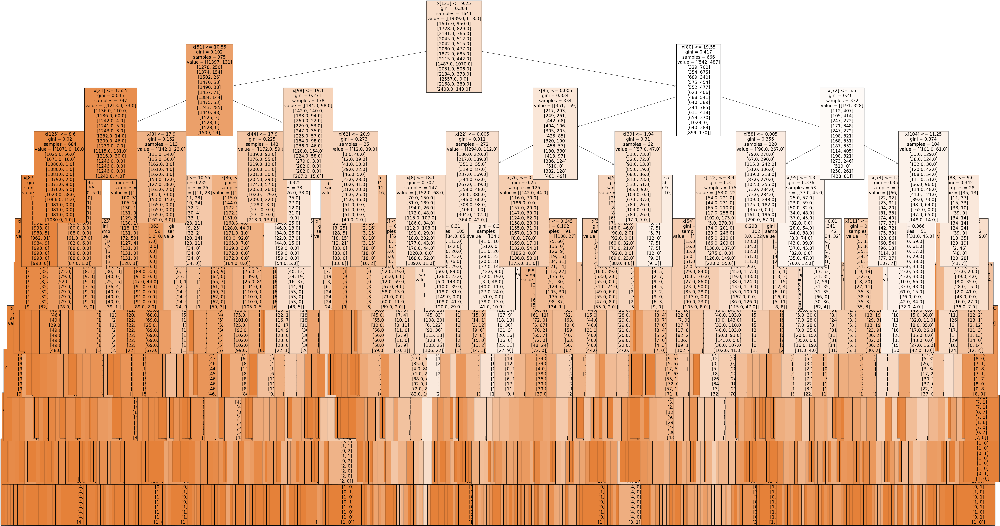

In [37]:
# Plot decision tree for 1960s data.

fig_60s = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

In [38]:
# Train the model on the 1970s data.

clf.fit(X_train_1970s, y_train_1970s)

# Perform predictions on the 1970s test dataset.

y_pred_1970s = clf.predict(X_test_1970s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_1970s, y_pred_1970s))

Model Accuracy:  0.5757299270072993


In [39]:
# Train the model on the 1980s data.

clf.fit(X_train_1980s, y_train_1980s)

# Perform predictions on the 1980s test dataset.

y_pred_1980s = clf.predict(X_test_1980s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_1980s, y_pred_1980s))

Model Accuracy:  0.5766423357664233


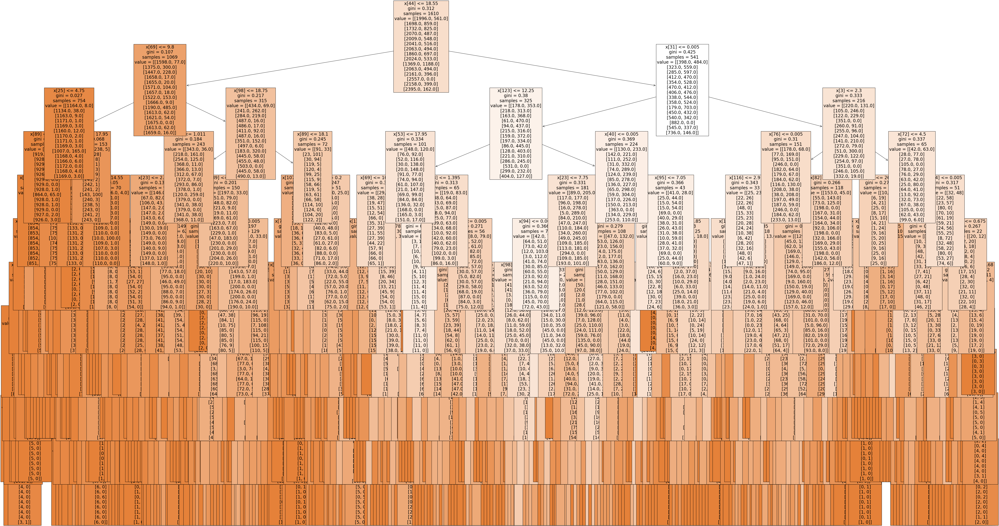

In [40]:
# Plot decision tree for 1980s data.

fig_80s = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

In [41]:
# Train the model on the 1990s data.

clf.fit(X_train_1990s, y_train_1990s)

# Perform predictions on the 1990s test dataset.

y_pred_1990s = clf.predict(X_test_1990s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_1990s, y_pred_1990s))

Model Accuracy:  0.5784671532846716


In [42]:
# Train the model on the 2000s data.

clf.fit(X_train_2000s, y_train_2000s)

# Perform predictions on the 2000s test dataset.

y_pred_2000s = clf.predict(X_test_2000s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_2000s, y_pred_2000s))

Model Accuracy:  0.5328467153284672


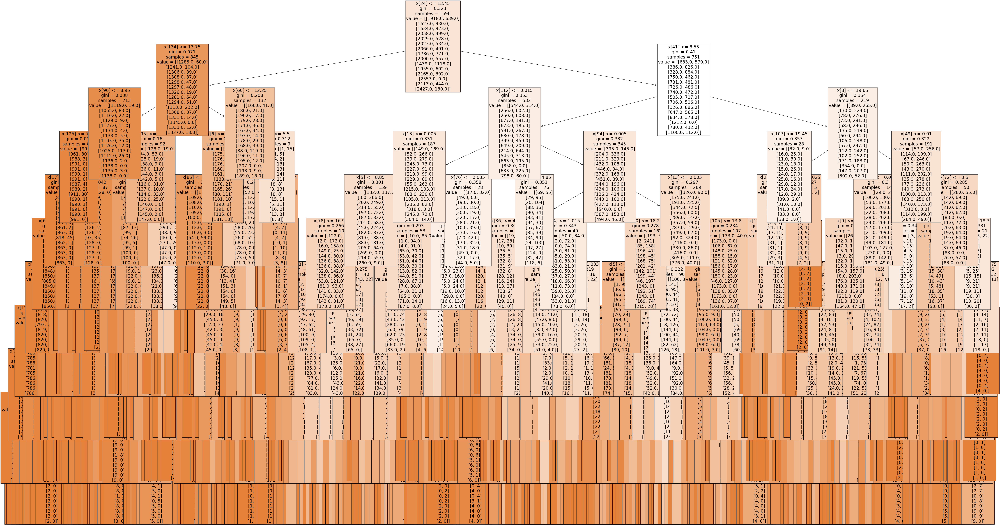

In [43]:
# Plot decision tree for 2000s data.

fig_00s = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

In [44]:
# Train the model on the 2010s data.

clf.fit(X_train_2010s, y_train_2010s)

# Perform predictions on the 2010s test dataset.

y_pred_2010s = clf.predict(X_test_2010s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_2010s, y_pred_2010s))

Model Accuracy:  0.531021897810219


In [45]:
# Train the model on the 2020s data.

clf.fit(X_train_2020s, y_train_2020s)

# Perform predictions on the 2020s test dataset.

y_pred_2020s = clf.predict(X_test_2020s)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_2020s, y_pred_2020s))

Model Accuracy:  0.5627009646302251


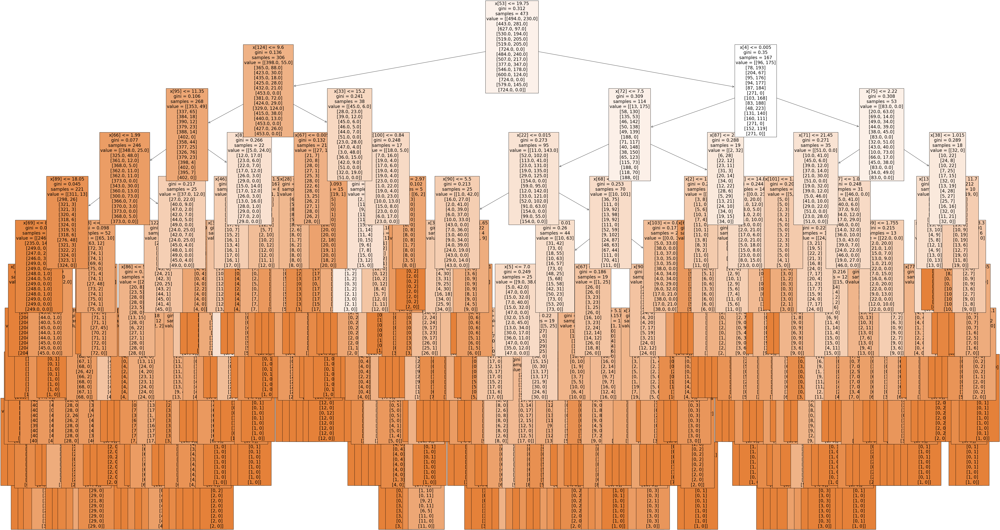

In [46]:
# Plot decision tree for 2020s data.

fig_20s = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

### 4. Create a list of the feature importances of the model and find which weather stations have the most influence on how the random forest divides up data.

In [47]:
# Create a list of feature importances for each decade.

important_1960s = pd.Series(clf.feature_importances_, index = X_1960s.columns).sort_values(ascending = False)
important_1960s

MUNCHENB_temp_mean           0.043890
DEBILT_temp_max              0.038311
DUSSELDORF_temp_max          0.035776
HEATHROW_temp_max            0.029562
BASEL_temp_max               0.028975
                               ...   
BUDAPEST_sunshine            0.000000
BUDAPEST_global_radiation    0.000000
BUDAPEST_pressure            0.000000
BUDAPEST_humidity            0.000000
VALENTIA_temp_max            0.000000
Length: 135, dtype: float64

In [48]:
# Reshape list of feature importances.

important = clf.feature_importances_.reshape(-1,15,9)
important

array([[[0.0050083 , 0.00626779, 0.00335519, 0.00747219, 0.02060811,
         0.01043545, 0.02885654, 0.00644119, 0.02897502],
        [0.00295061, 0.00218274, 0.00408089, 0.00132592, 0.01149294,
         0.00471584, 0.01231875, 0.00378751, 0.00929929],
        [0.        , 0.        , 0.        , 0.        , 0.0082892 ,
         0.        , 0.00539689, 0.00354185, 0.00559482],
        [0.00264489, 0.00456139, 0.00766144, 0.01396774, 0.02417928,
         0.00936623, 0.00548106, 0.00556095, 0.03831054],
        [0.00263825, 0.00463931, 0.00623215, 0.00590902, 0.01799512,
         0.00930544, 0.01340531, 0.00418014, 0.03577643],
        [0.00357539, 0.00476287, 0.00749678, 0.00550192, 0.00982976,
         0.00583572, 0.01371001, 0.00365494, 0.02956175],
        [0.00348275, 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        ],
        [0.00428511, 0.00484191, 0.00496642, 0.00947813, 0.01512003,
         0.00693086, 0.01873944, 0.0054946

In [49]:
# Check shape of feature importances array.

important.shape

(1, 15, 9)

In [50]:
# Collapse features importances array into one observation for each weather station.

cities_importance = np.sum(important[0], axis=1)
cities_importance

array([0.11741979, 0.05215449, 0.02282276, 0.11173351, 0.10008117,
       0.08392914, 0.00348275, 0.0930506 , 0.09090353, 0.07098689,
       0.10782765, 0.0624061 , 0.03500117, 0.04820046, 0.        ])

In [51]:
# Create list comprehension to output cities importance.

lst = [x for x in cities_importance if x > .05]
lst

[0.11741978927208932,
 0.05215448675097527,
 0.1117335102162589,
 0.10008117337348638,
 0.0839291356250941,
 0.09305059714616362,
 0.09090353313350419,
 0.07098689339625865,
 0.10782764879499825,
 0.0624060977113509]

In [52]:
# Create dictionary for weather stations related to cities_importance.

dct = {cities[x]:cities_importance[x] for x in range(len(cities))} # See Section 1, Cell 6 for cities definition.
dct

{'Basel': 0.11741978927208932,
 'Belgrade': 0.05215448675097527,
 'Budapest': 0.022822759119346493,
 'Debilt': 0.1117335102162589,
 'Dusseldorf': 0.10008117337348638,
 'Heathrow': 0.0839291356250941,
 'Kassel': 0.003482745775524737,
 'Ljubljana': 0.09305059714616362,
 'Maastricht': 0.09090353313350419,
 'Madrid': 0.07098689339625865,
 'Munchen': 0.10782764879499825,
 'Oslo': 0.0624060977113509,
 'Sonnblick': 0.035001172566465434,
 'Stockholm': 0.04820045711848378,
 'Valentia': 0.0}

In [53]:
# Create Pandas series of above weather stations/cities_importance dictionary.

ser = pd.Series(dct)
ser

Basel         0.117420
Belgrade      0.052154
Budapest      0.022823
Debilt        0.111734
Dusseldorf    0.100081
Heathrow      0.083929
Kassel        0.003483
Ljubljana     0.093051
Maastricht    0.090904
Madrid        0.070987
Munchen       0.107828
Oslo          0.062406
Sonnblick     0.035001
Stockholm     0.048200
Valentia      0.000000
dtype: float64

In [54]:
# Sort series by order of importance.

ser.sort_values(ascending=False)

Basel         0.117420
Debilt        0.111734
Munchen       0.107828
Dusseldorf    0.100081
Ljubljana     0.093051
Maastricht    0.090904
Heathrow      0.083929
Madrid        0.070987
Oslo          0.062406
Belgrade      0.052154
Stockholm     0.048200
Sonnblick     0.035001
Budapest      0.022823
Kassel        0.003483
Valentia      0.000000
dtype: float64

### 5. Plot a bar chart of the importances against a list of the weather stations.

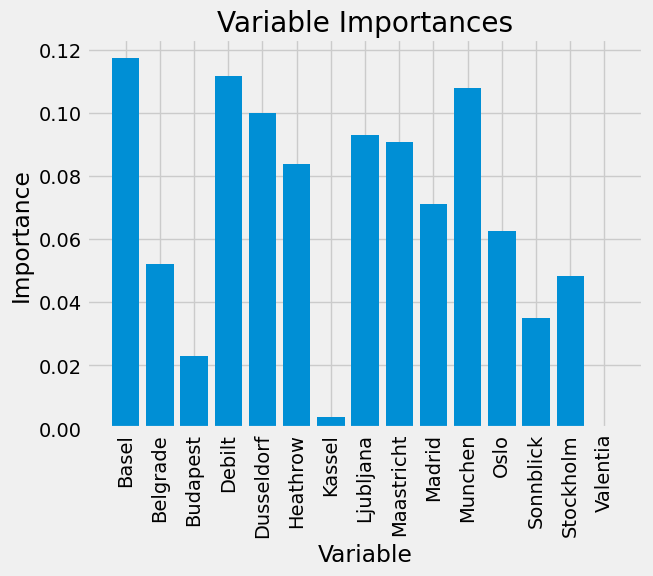

In [58]:
# Plot bar chart of importances by cities.

%matplotlib inline

plt.style.use('fivethirtyeight')
# list of x locations for plotting
x_values = list(cities)

plt.bar(x_values, ser, orientation = 'vertical')
plt.xticks(x_values, cities, rotation='vertical')
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

### 6. Create three subsets of original data set (including all decades): One subset for each of the top three most important stations from Section 5 directly above.

In [78]:
# Reexamine original weather data set.

df_w

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,...,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,1960-01-01,1,7,0.85,1.0180,0.32,0.09,0.7,6.5,0.8,...,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,1960-01-02,1,6,0.84,1.0180,0.36,1.05,1.1,6.1,3.3,...,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,1960-01-03,1,8,0.90,1.0180,0.18,0.30,0.0,8.5,5.1,...,4.1,7,0.91,1.0096,0.17,0.08,0.1,10.5,8.1,12.9
3,1960-01-04,1,3,0.92,1.0180,0.58,0.00,4.1,6.3,3.8,...,2.3,7,0.86,1.0184,0.13,0.98,0.0,7.4,7.3,10.6
4,1960-01-05,1,6,0.95,1.0180,0.65,0.14,5.4,3.0,-0.7,...,4.3,3,0.80,1.0328,0.46,0.00,5.7,5.7,3.0,8.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,2022-10-27,10,1,0.79,1.0248,1.34,0.22,7.7,15.9,11.4,...,14.2,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22946,2022-10-28,10,6,0.77,1.0244,1.34,0.22,5.4,16.7,14.3,...,14.3,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22947,2022-10-29,10,4,0.76,1.0227,1.34,0.22,6.1,16.7,13.1,...,14.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5
22948,2022-10-30,10,5,0.80,1.0212,1.34,0.22,5.8,15.4,11.6,...,12.4,5,0.82,1.0142,1.13,0.41,3.4,10.7,7.9,13.5


In [83]:
# Reexamine original pleasant weather data set.

df_pw

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
0,1960-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1960-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1960-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1960-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1960-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,2022-10-27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22946,2022-10-28,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22947,2022-10-29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
22948,2022-10-30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [81]:
# Subset weather data set to include all columns with "BASEL" in the column name.

df_w_basel = df_w.filter(like='BASEL') 
df_w_basel

,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max
0,7,0.85,1.0180,0.32,0.09,0.7,6.5,0.8,10.9
1,6,0.84,1.0180,0.36,1.05,1.1,6.1,3.3,10.1
2,8,0.90,1.0180,0.18,0.30,0.0,8.5,5.1,9.9
3,3,0.92,1.0180,0.58,0.00,4.1,6.3,3.8,10.6
4,6,0.95,1.0180,0.65,0.14,5.4,3.0,-0.7,6.0
...,...,...,...,...,...,...,...,...,...
22945,1,0.79,1.0248,1.34,0.22,7.7,15.9,11.4,21.4
22946,6,0.77,1.0244,1.34,0.22,5.4,16.7,14.3,21.9
22947,4,0.76,1.0227,1.34,0.22,6.1,16.7,13.1,22.4
22948,5,0.80,1.0212,1.34,0.22,5.8,15.4,11.6,21.1


In [84]:
# Subset pleasant weather data set to include all columns with "BASEL" in the column name.

df_pw_basel = df_pw.filter(like='BASEL') 
df_pw_basel

,BASEL_pleasant_weather
0,0
1,0
2,0
3,0
4,0
...,...
22945,0
22946,0
22947,0
22948,0


In [159]:
# Check value counts for Basel pleasant weather data.

df_pw_basel['BASEL_pleasant_weather'].value_counts(dropna=False)

BASEL_pleasant_weather
0    17286
1     5664
Name: count, dtype: int64

In [82]:
# Subset weather data set to include all columns with "DEBILT" in the column name.

df_w_debilt = df_w.filter(like='DEBILT') 
df_w_debilt

,DEBILT_cloud_cover,DEBILT_humidity,DEBILT_pressure,DEBILT_global_radiation,DEBILT_precipitation,DEBILT_sunshine,DEBILT_temp_mean,DEBILT_temp_min,DEBILT_temp_max
0,7,0.85,1.0032,0.07,0.25,0.0,9.3,7.4,11.0
1,8,0.90,1.0056,0.14,0.06,0.1,7.7,6.4,8.3
2,6,0.92,1.0165,0.28,0.01,3.0,6.8,4.6,9.9
3,8,0.95,1.0265,0.08,0.09,0.0,6.7,3.6,10.1
4,6,0.90,1.0243,0.04,0.39,0.0,8.0,2.4,11.2
...,...,...,...,...,...,...,...,...,...
22945,8,0.84,1.0190,1.13,0.22,2.8,15.7,12.8,19.4
22946,8,0.84,1.0177,1.13,0.22,3.5,16.0,10.3,20.5
22947,8,0.86,1.0174,1.13,0.22,3.3,15.8,9.3,21.1
22948,8,0.87,1.0174,1.13,0.22,6.0,14.4,10.3,20.2


In [85]:
# Subset pleasant weather data set to include all columns with "DEBILT" in the column name.

df_pw_debilt = df_pw.filter(like='DEBILT') 
df_pw_debilt

,DEBILT_pleasant_weather
0,0
1,0
2,0
3,0
4,0
...,...
22945,0
22946,0
22947,0
22948,0


In [86]:
# Subset weather data set to include all columns with "MUNCHEN" in the column name.

df_w_munchen = df_w.filter(like='MUNCHEN') 
df_w_munchen

,MUNCHENB_cloud_cover,MUNCHENB_humidity,MUNCHENB_pressure,MUNCHENB_global_radiation,MUNCHENB_precipitation,MUNCHENB_sunshine,MUNCHENB_temp_mean,MUNCHENB_temp_min,MUNCHENB_temp_max
0,5,0.67,1.0304,0.20,0.10,0.0,6.9,1.1,10.4
1,6,0.72,1.0292,0.61,0.30,5.1,6.2,4.2,10.2
2,6,0.91,1.0320,0.20,0.30,0.0,5.8,4.0,8.0
3,6,0.90,1.0443,0.20,0.01,0.0,3.9,3.2,5.4
4,5,0.85,1.0430,0.65,0.96,5.6,1.8,-3.0,6.0
...,...,...,...,...,...,...,...,...,...
22945,2,0.76,1.0263,1.37,0.26,9.7,14.3,8.3,22.2
22946,6,0.70,1.0263,1.37,0.26,7.7,16.1,8.9,26.1
22947,7,0.64,1.0263,1.37,0.26,6.8,17.4,11.2,26.2
22948,6,0.75,1.0263,1.37,0.26,8.3,14.5,9.2,23.5


In [87]:
# Subset pleasant weather data set to include all columns with "MUNCHEN" in the column name.

df_pw_munchen = df_pw.filter(like='MUNCHEN') 
df_pw_munchen

,MUNCHENB_pleasant_weather
0,0
1,0
2,0
3,0
4,0
...,...
22945,0
22946,0
22947,0
22948,0


### 7. Create another random forest model for each of the 3 stations from Section 6 and graph the importance of the observations.

In [164]:
# Set tensorflow random seed generator.

tf.random.set_seed(42)

In [165]:
# Create X matrices for each of the three cities from Section 6.

X_basel = df_w_basel
X_debilt = df_w_debilt
X_munchen = df_w_munchen

In [166]:
# Create y matrices for each of the three cities from Section 6.

y_basel = df_pw_basel
y_debilt = df_pw_debilt
y_munchen = df_pw_munchen

In [167]:
# Check shapes for X and y sets for Basel. The other two cities (Debilt and Munchen) are presumed to have the same shape.

print(X_basel.shape)
print(y_basel.shape)

(22950, 9)
(22950, 1)


In [168]:
# Split each of the three cities into training and testing sets.

X_train_basel, X_test_basel, y_train_basel, y_test_basel = train_test_split(X_basel,y_basel,test_size=0.3)
X_train_debilt, X_test_debilt, y_train_debilt, y_test_debilt = train_test_split(X_debilt,y_debilt,test_size=0.3)
X_train_munchen, X_test_munchen, y_train_munchen, y_test_munchen = train_test_split(X_munchen,y_munchen,test_size=0.3)

In [169]:
# Check shapes for X and y test and training sets for Basel. The other two cities (Debilt and Munchen) are presumed to have the same shape.

print(X_train_basel.shape, y_train_basel.shape)
print(X_test_basel.shape, y_test_basel.shape)

(16065, 9) (16065, 1)
(6885, 9) (6885, 1)


In [170]:
# Create a RF classifier.

clf = RandomForestClassifier(n_estimators = 100, max_depth=10)

In [171]:
# Train the model on the Basel data.

clf.fit(X_train_basel, y_train_basel)

# Perform predictions on the Basel test dataset.

y_pred_basel = clf.predict(X_test_basel)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_basel, y_pred_basel))

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Accuracy:  1.0


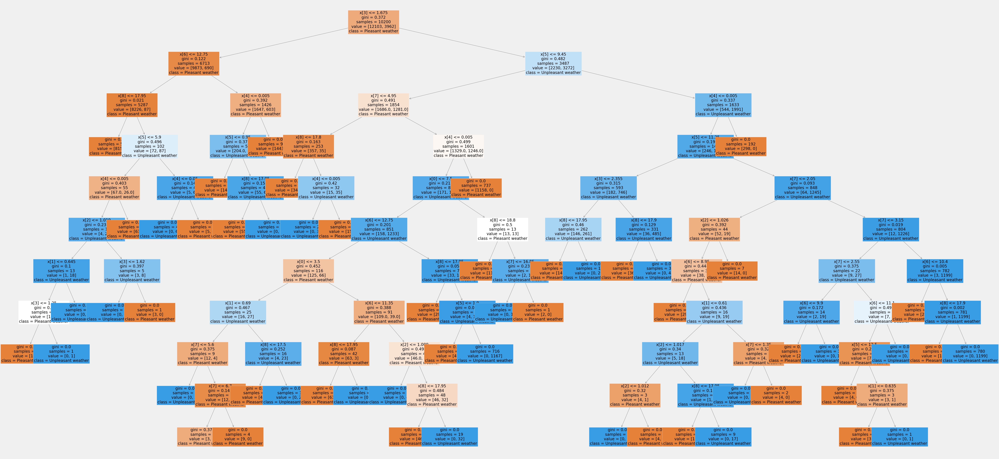

In [172]:
# Plot decision tree for Basel data.

fig_basel = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

In [173]:
# Train the model on Debilt data.

clf.fit(X_train_debilt, y_train_debilt)

# Perform predictions on the Debilt test dataset.

y_pred_debilt = clf.predict(X_test_debilt)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_debilt, y_pred_debilt))

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Accuracy:  1.0


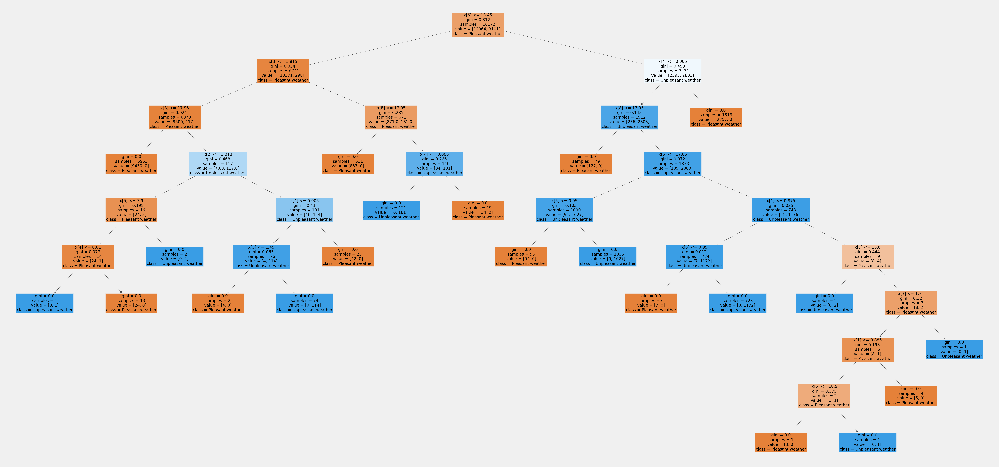

In [174]:
# Plot decision tree for Debilt data.

fig_basel = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

In [175]:
# Train the model on Munchen data.

clf.fit(X_train_munchen, y_train_munchen)

# Perform predictions on the Munchen test dataset.

y_pred_munchen = clf.predict(X_test_munchen)
  
# Use metrics module for accuracy calculation.

print("Model Accuracy: ", metrics.accuracy_score(y_test_munchen, y_pred_munchen))

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Accuracy:  1.0


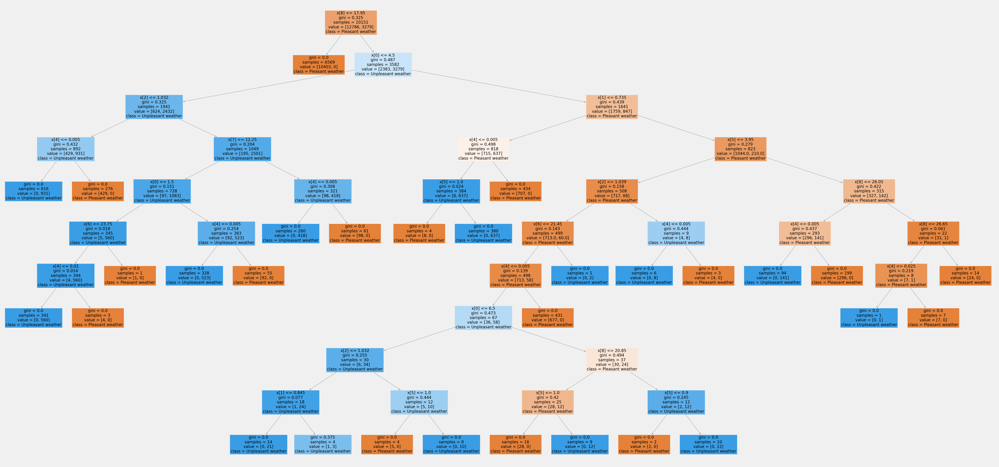

In [176]:
# Plot decision tree for Munchen data.

fig_basel = plt.figure(figsize=(80,40))
plot_tree(clf.estimators_[5], fontsize = 20, class_names=predictions, filled=True); # See Section 1, Cell 8 for predictions definition.

In [125]:
# Create a list of feature importances for Basel.

lst_basel = pd.Series(clf.feature_importances_, index = X_basel.columns).sort_values(ascending = False)
lst_basel

BASEL_precipitation       0.379644
BASEL_temp_max            0.252737
BASEL_temp_mean           0.154980
BASEL_sunshine            0.078681
BASEL_cloud_cover         0.053328
BASEL_global_radiation    0.040601
BASEL_temp_min            0.017497
BASEL_pressure            0.012330
BASEL_humidity            0.010203
dtype: float64

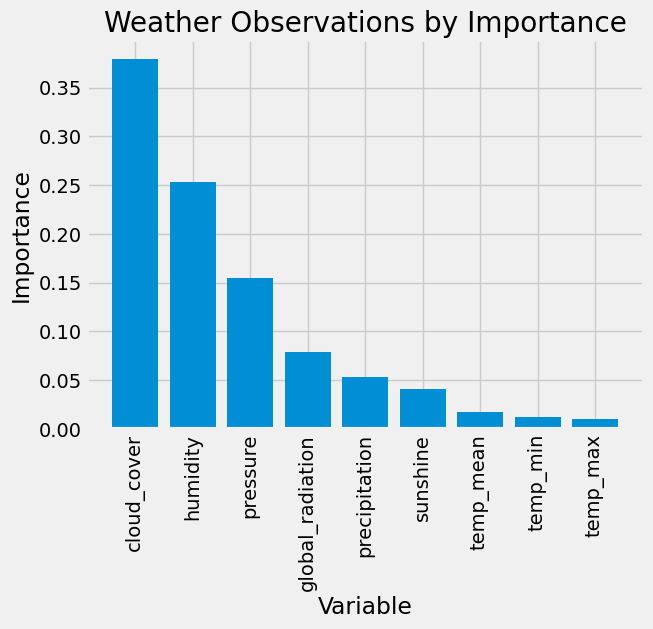

In [143]:
# Plot bar chart of importances by weather observation.

%matplotlib inline

plt.style.use('fivethirtyeight')
x_values = list(observations) # See Section 1, Cell 7 for observations definition.

plt.bar(x_values, lst_basel, orientation = 'vertical')
plt.xticks(x_values, observations, rotation='vertical')
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Weather Observations by Importance');